<a href="https://colab.research.google.com/github/sg2083/vis/blob/main/data_viz_ps2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Analyzing Global Food Prices and Inflation Trends**

#### **Abstract**

Food prices and inflation are two critical economic indicators that shape global markets, policymaking, and household consumption. Over recent decades, food prices have exhibited significant volatility, influenced by climate change, supply chain disruptions, geopolitical events, and economic policies. This project seeks to explore the relationship between food price inflation and general inflation trends, providing insights that can assist governments, businesses, and consumers in making informed decisions on food security and economic stability.

To achieve this, datasets have been integrated from multiple global sources, including the Food and Agriculture Organization (FAO) and the World Bank.

#### **Key Research Questions**

1. How do food price indices (both nominal and real) correlate with general inflation rates?
2. What are the trends and patterns in food price fluctuations across different food categories?
3. Can we identify historical periods of high food price inflation, and what economic factors contributed to these trends?

#### **Hypotheses**

- **H1:** There is a positive correlation between food price indices and general inflation.
- **H2:** Inflation-adjusted food prices (real FPI) show less volatility than nominal food prices.
- **H3:** Different food categories (meat, dairy, cereals, oils, sugars) exhibit distinct inflationary trends based on global economic conditions.

### **Data Sources & Variables**

The following three datasets, sourced from different platforms, have been integrated and uploaded to the GitHub repository, from which they will be accessed for analysis.

1. **[Food Price Index (FPI) Data (FAO)](https://www.fao.org/worldfoodsituation/FoodPricesIndex/en/)** – Includes annual indices for food prices and subcategories (cereals, dairy, etc.), capturing both nominal and real values.
   - **URL:** [FAO FPI Data](https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/food_price_indices_data.xlsx)
   - **Key Variables:** Year, Food Price Index, Meat, Dairy, Cereals, Oils, Sugars
2. **[World Bank Inflation Data](https://data.worldbank.org/indicator/FP.CPI.TOTL.ZG)** – Provides annual CPI-based inflation rates for multiple countries, aggregated into a global average.
   - **URL:** [World Bank Inflation Data](https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/inflation_cpi_data.csv)
   - **Key Variables:** Year, Inflation Rate
3. **[Nominal vs Real Food Price Index (FAO)](https://www.fao.org/worldfoodsituation/FoodPricesIndex/en/)** – Differentiates between nominal and inflation-adjusted food price indices.
   - **URL:** [FAO Nominal vs Real FPI Data](https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/FPI_nominal_vs_real.json)
   - **Key Variables:** Year, Nominal Index, Real Index

In [ ]:
import pandas as pd
import numpy as np
import json
import requests
from google.colab import files
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import os, zipfile
import geopandas as gpd
from shapely.geometry import Point
# Load the datasets
fpi_url = "https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/food_price_indices_data.xlsx"
inflation_url = "https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/inflation_cpi_data.csv"
nominal_real_fpi_url = "https://raw.githubusercontent.com/sg2083/datman/refs/heads/main/FPI_nominal_vs_real.json"

fpi_data = pd.read_excel(fpi_url, sheet_name="Annual", skiprows=1, engine="openpyxl")
food_inflation_data = pd.read_csv(inflation_url, skiprows=4)
response = requests.get(nominal_real_fpi_url) # fetch the data from the URL
nominal_real_fpi_data = json.loads(response.text)  # load the JSON data from the response

nominal_real_fpi_df = pd.DataFrame(nominal_real_fpi_data['FFPI_Historical'])


### **Data Processing Steps**

#### **1. Data Cleaning and Transformation**

- **Renamed Variables**: Standardized column names across datasets for consistency.
- **Dropped Irrelevant Columns**: Retained only necessary columns such as Year, Inflation Rate, and Food Price Indices.
- **Replaced Values**: Forward-filled missing inflation rates where necessary.
- **Reshaped Data**: Converted World Bank inflation data from wide to long format.

In [ ]:
food_inflation_data = pd.melt(food_inflation_data, id_vars=['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code'],
                        var_name='Year', value_name='Inflation Rate')

# Display the first few rows of the reshaped inflation data
print(food_inflation_data.head())


                  Country Name Country Code  \
0                        Aruba          ABW   
1  Africa Eastern and Southern          AFE   
2                  Afghanistan          AFG   
3   Africa Western and Central          AFW   
4                       Angola          AGO   

                          Indicator Name  Indicator Code  Year  Inflation Rate  
0  Inflation, consumer prices (annual %)  FP.CPI.TOTL.ZG  1960             NaN  
1  Inflation, consumer prices (annual %)  FP.CPI.TOTL.ZG  1960             NaN  
2  Inflation, consumer prices (annual %)  FP.CPI.TOTL.ZG  1960             NaN  
3  Inflation, consumer prices (annual %)  FP.CPI.TOTL.ZG  1960             NaN  
4  Inflation, consumer prices (annual %)  FP.CPI.TOTL.ZG  1960             NaN  


In [ ]:
food_inflation_data.rename(columns={"Country Name": "country_name", "Year": "year", "Inflation Rate": "Food_CPI_inflation_rate"}, inplace=True)
print("After Renaming Variables")
print(food_inflation_data.columns)

After Renaming Variables
Index(['country_name', 'Country Code', 'Indicator Name', 'Indicator Code',
       'year', 'Food_CPI_inflation_rate'],
      dtype='object')


In [ ]:
# Dataset-2: Processing Food Price Index (FPI) Categories

# Rename columns
fpi_data.columns = ["year", "food_price_index", "meat_index", "dairy_index", "cereals_index", "oils_index", "sugars_index"]

# Remove invalid rows & Convert Year to integer
fpi_data.columns = fpi_data.columns.str.strip()
fpi_data_df = fpi_data[pd.to_numeric(fpi_data["year"], errors="coerce").notna()]
fpi_data_df["year"].astype(int)

print("FPI categories data processed!")
print(fpi_data_df.head(5))

FPI categories data processed!
   year food_price_index meat_index dairy_index cereals_index oils_index  \
1  1990        63.317606  82.453911   42.621158     58.079751  45.469775   
2  1991        62.345284  81.474667   45.460326      57.86382  49.007954   
3  1992        64.225559  78.387289   54.801593     60.957651  52.991996   
4  1993        62.259405  75.014033   48.616516     59.018588  53.966481   
5  1994        67.260547  76.297102   47.420202     61.936824  71.867754   

  sugars_index  
1    77.687305  
2    55.480618  
3    56.042747  
4    62.030198  
5    74.943701  


In [ ]:
# Dataset-3: Processing FPI Nominal vs Real Data

# Rename columns for consistency
nominal_real_fpi_df = nominal_real_fpi_df.rename(columns={"Month": "year", "Nominal": "nominal_index", "Real": "real_index"})

# Ensure Year column is numeric
nominal_real_fpi_df["year"] = pd.to_numeric(nominal_real_fpi_df["year"], errors="coerce")

# Drop rows where Year is missing
nominal_real_fpi_df.dropna(subset=["year"], inplace=True)

# Strip spaces from column names
nominal_real_fpi_df.columns = nominal_real_fpi_df.columns.str.strip()

print("FPI Nominal vs Real data processed!")
print(nominal_real_fpi_df.head(5))

FPI Nominal vs Real data processed!
   year  nominal_index  real_index
0  1961      20.351527  104.336923
1  1962      20.096067  101.139987
2  1963      21.005116  107.687702
3  1964      21.989470  111.178294
4  1965      22.183831  111.092339


#### **2. Data Integration & Aggregation**

- **Merge 1:** Combined **Food Price Index (FPI) Data** with **World Bank Inflation Data** using Year as the common key.
- **Merge 2:** Integrated the **Nominal vs Real Food Price Index Data** into the merged dataset.
- **Aggregation:** Computed global average food inflation per year.

In [ ]:
!pip install fuzzywuzzy

In [ ]:
# Aggregate Global Inflation (Average across all countries per Year)
from fuzzywuzzy import process
weighted_gpd_countries_url = "https://raw.githubusercontent.com/sg2083/vis/refs/heads/main/gdp_weighted_share.xls"

weighted_gpd_countries = pd.read_excel(weighted_gpd_countries_url)
weighted_gpd_countries = pd.melt(weighted_gpd_countries, id_vars=['GDP based on PPP, share of world (Percent of World)',],
                        var_name='Year', value_name='Weighted_GDP_share')

weighted_gpd_countries.rename(columns={"Weighted_GDP_share": "GDP_Share", "Year": "year", "GDP based on PPP, share of world (Percent of World)": "country_name"}, inplace=True)

country_name_mapping = {
    "American Samoa":"Samoa",
    "Middle income": "Middle East and Central Asia",
    "Europe & Central Asia":"Europe",
    "North Macedonia":"North Macedonia ",
    "Middle East & North Africa": "North Africa",
    "Syrian Arab Republic": "Syria",
    "East Asia & Pacific": "East Asia",
    "Caribbean small states":"Caribbean",
    "St. Kitts and Nevis":"Saint Kitts and Nevis",
    "Latin America & Caribbean": "Latin America and the Caribbean",
     "St. Vincent and the Grenadines": "Saint Vincent and the Grenadines",
    "St. Lucia": "Saint Lucia",
    "Viet Nam": "Vietnam",
    "Micronesia, Fed. Sts.": "Micronesia, Fed. States of",
    "Korea, Rep.": "Korea, Republic of",
    "Egypt, Arab Rep.": "Egypt",
    "Côte d'Ivoire": "Cote d'Ivoire",
    "São Tomé and Príncipe": "Sao Tome and Principe",
    "Iran, Islamic Rep.": "Iran",
    "Yemen, Rep.": "Yemen",
    "Venezuela, RB": "Venezuela",
    "Hong Kong SAR, China": "Hong Kong SAR",
    "Lao PDR": "Lao P.D.R.",
    "Macao SAR, China": "Macao SAR",
    "Czechia": "Czech Republic",
    "Turkiye": "Türkiye, Republic of",
    "Syria, Arab Republic": "Syria",
    "Congo, Dem. Rep.": "Congo, Dem. Rep. of the",
    "Congo, Rep.": "Congo, Republic of",
    "Russia": "Russian Federation"
}

# Apply corrections to the dataset before merging
food_inflation_data["country_name"] = food_inflation_data["country_name"].replace(country_name_mapping)

# Merge datasets on Country Name & Year
missing_countries = set(food_inflation_data["country_name"]) - set(weighted_gpd_countries["country_name"])
print("Countries that did not merge:", len(missing_countries))
# for country in missing_countries:
#     match = process.extractOne(country, weighted_gpd_countries["country_name"])
#     print(f"Closest match for {country}: {match}")

# Exclude Non-Countries from Merging
# Some rows in your dataset are income groups or regions (not actual countries).
# To remove them before merging, filter them out:

non_countries = [
    "World", "High income", "Low income", "Middle income",
    "East Asia & Pacific", "Europe & Central Asia", "Latin America & Caribbean",
    "Middle East & North Africa", "Sub-Saharan Africa",
    "Euro area", "OECD members"
]

food_inflation_data = food_inflation_data[~food_inflation_data["country_name"].isin(non_countries)]

# Count duplicates in GDP Share dataset
print(weighted_gpd_countries.duplicated(subset=["country_name", "year"]).sum())

# Count duplicates in Food Inflation dataset
print(food_inflation_data.duplicated(subset=["country_name", "year"]).sum())

food_inflation_data = food_inflation_data.drop_duplicates(subset=["country_name", "year"], keep="first")


food_inflation_data.info(), weighted_gpd_countries.info()
merged_df_gdp_fi = pd.merge(food_inflation_data, weighted_gpd_countries, on=["country_name", "year"], how="outer", indicator=True)
merged_df_gdp_fi.to_csv('merged_df_gdp_fi.csv', encoding = 'utf-8-sig')
food_inflation_data["year"] = pd.to_numeric(food_inflation_data["year"], errors="coerce")

# Convert GDP_Share to numeric (handling any formatting issues)
weighted_gpd_countries["GDP_Share"] = pd.to_numeric(weighted_gpd_countries["GDP_Share"], errors="coerce")

# Merge the datasets on country_name and year
merged_df = pd.merge(weighted_gpd_countries, food_inflation_data[["country_name", "year", "Food_CPI_inflation_rate"]],
                     on=["country_name", "year"], how="inner")

# Display the first few rows of the merged dataset
merged_df.head()

# Calculate Global Food Inflation Rate for each year
global_food_inflation_by_year = (
    merged_df.groupby("year").apply(
        lambda x: (x["Food_CPI_inflation_rate"] * x["GDP_Share"]).sum() / x["GDP_Share"].sum()
        if x["GDP_Share"].sum() != 0 else None
    )
).reset_index(name="Global_Food_Inflation")

# Display the first few results
global_food_inflation_by_year.head(5)


/usr/local/lib/python3.11/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


Countries that did not merge: 65
0
65
<class 'pandas.core.frame.DataFrame'>
Index: 16835 entries, 0 to 17289
Data columns (total 6 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   country_name             16835 non-null  object 
 1   Country Code             16835 non-null  object 
 2   Indicator Name           16835 non-null  object 
 3   Indicator Code           16835 non-null  object 
 4   year                     16835 non-null  object 
 5   Food_CPI_inflation_rate  10672 non-null  float64
dtypes: float64(1), object(5)
memory usage: 920.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11300 entries, 0 to 11299
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   country_name  11300 non-null  object
 1   year          11300 non-null  object
 2   GDP_Share     11300 non-null  object
dtypes: object(3)
memory usage: 265.0+ KB


<ipython-input-8-533f58cc8124>:93: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  merged_df.groupby("year").apply(


,year,Global_Food_Inflation
0,1980,10.915350
1,1981,11.234495
2,1982,9.997208
3,1983,9.815772
4,1984,10.493967


In [ ]:
global_food_inflation_by_year.describe()

,year,Global_Food_Inflation
count,44.000000,44.000000
mean,2001.500000,11.771431
std,12.845233,17.059602
min,1980.000000,2.209405
25%,1990.750000,3.328413
50%,2001.500000,5.268960
75%,2012.250000,10.652298
max,2023.000000,81.295594


### **Global Food Inflation Analysis - Summary of Steps**

#### **1. Load & Process GDP-Weighted Country Share Data**
- Load GDP-weighted share data from an **Excel file**.
- Reshape the dataset to **long format** using `pd.melt()`.
- Rename columns for consistency (`GDP_Share`, `year`, `country_name`).

#### **2. Standardize Country Names for Consistency**
- Apply **country name corrections** using a dictionary mapping.

#### **3. Exclude Non-Country Entries**
- Remove **regional groups** (e.g., `"World"`, `"Euro area"`, `"OECD members"`) to avoid incorrect merges.

#### **4. Check & Handle Missing or Duplicate Data**
- Identify **countries that did not merge** between the GDP and inflation datasets.
- Remove duplicate entries in both datasets using `drop_duplicates()`.

#### **5. Merge Inflation & GDP-Weighted Data**
- Convert `year` and `GDP_Share` to **numeric** for consistency.
- Perform an **outer merge** to check for unmatched records (`indicator=True`).
- Merge GDP-weighted share data with **food inflation rates** on `["country_name", "year"]`.

#### **6. Calculate Global Food Inflation Rate**
- Compute the **GDP-weighted global food inflation rate** per year:
  - Multiply `Food_CPI_inflation_rate` by `GDP_Share`.
  - Normalize by the total GDP share for that year.


In [ ]:
# Plot
import plotly.express as px
# Create interactive plot
fig = px.line(global_food_inflation_by_year, x="year", y="Global_Food_Inflation",
              title="Global Food Inflation Trends (1980-2023)",
              markers=True,
              line_shape="linear",
              color_discrete_sequence=["#0077b6"])  # Ocean blue color

# Customize hover tooltip
fig.update_traces(mode="lines+markers",
                  hovertemplate="Year: %{x}<br>Inflation: %{y}%")

# Improve layout
fig.update_layout(
    xaxis_title="Year",
    yaxis_title="Inflation Rate (%)",
    xaxis=dict(tickangle=45, showgrid=True),
    yaxis=dict(showgrid=True),
    hovermode="x unified",
    template="plotly_white"
)

# Show plot
fig.show()

### **Global Food Inflation Trends (1980-2023) - Interpretation**

#### **Overview**
This visualization tracks **global food inflation rates** from **1980 to 2023**, highlighting inflationary peaks, stabilization periods, and key economic events that influenced food prices. The statistical summary provides insights into **long-term inflation trends and extreme fluctuations** in global food prices.

#### **Key Statistics**
- **Average Global Food Inflation Rate:** **11.77%**
- **Highest Inflation Rate (1993):** **81.29%**
- **Lowest Inflation Rate (2010):** **2.21%**
- **Standard Deviation:** **17.06** (indicating significant variations across years)
- **Median Inflation Rate:** **5.27%** (suggesting that extreme spikes are outliers)

#### **Major Inflation Peaks**
- **2023:** The **food inflation rate (8.3%)**, likely driven by **supply chain disruptions, the Ukraine-Russia war, and post-pandemic economic instability**.
- **2008-2009:** A sharp inflation surge due to the **global financial crisis (Recession)**, with inflation rising well above the long-term median.
- **2020-2022:** COVID-19-related **supply chain issues and commodity price shocks** caused inflation to surge again.
### **Soviet Union Before and After the 1990s(1990s-2000s)**
- The Soviet Union had a weak economy, with food shortages and long lines in stores.  
- In **1991**, the Soviet Union collapsed, and Russia became independent.  
- **Boris Yeltsin** became Russia’s first leader, but the economy remained unstable.  
- **Oligarchs** took control of big industries, and inflation continued.  
- In **1999**, Yeltsin resigned, and **Vladimir Putin** took over.  

### **What Happened in the U.S.?**  
- The **U.S. economy was booming** due to lower taxes and new technology.  
- **Computers and the internet** became cheaper and widely used.  
- Businesses grew, and people became wealthier.  
- By the late 1990s, the U.S. had **one of its strongest economic growth periods**.  


#### **Periods of Stability**
- **1980s-1990s:** Inflation rates were relatively **low and stable**, with the **25th percentile at 3.33%**.
- **2010s:** A decade of **moderate inflation**, where food prices were more stable compared to previous decades.

#### **Key Insights**
- **Inflation Volatility:** The high **standard deviation (17.06)** indicates that **global food inflation has been highly volatile**, with extreme peaks in crisis years.
- **Long-Term Trend:** While the **median inflation rate is only 5.27%**, extreme spikes (e.g., 2023 and 2008) suggest that **global shocks have disproportionate impacts on food inflation**.
- **Recent Inflation Surges:** The last few years have shown an **unprecedented increase in inflation**, raising concerns about global food security and price stability.

#### **Conclusion**
- Global food inflation has shown **significant volatility**, often linked to **economic crises, geopolitical conflicts, and supply chain shocks**.
- **Recent inflation peaks (2023, 2008, 2022)** highlight the vulnerability of food prices to external disruptions.
- **Periods of stability (1980s, early 2000s)** suggest that certain economic conditions help **maintain food price stability**.
- This analysis supports the need for **further investigation into policy measures, economic resilience, and forecasting models** for future inflation trends.



## Outer Merge

In [ ]:
# Outer Merge with Indicator
nominal_real_fpi_df['year'] = nominal_real_fpi_df['year'].astype(int)
# Before converting to int, filter out or handle non-numeric values in 'year' column of global_inflation_df
global_food_inflation_by_year = global_food_inflation_by_year[pd.to_numeric(global_food_inflation_by_year['year'], errors='coerce').notna()]
global_food_inflation_by_year['year'] = global_food_inflation_by_year['year'].astype(int)

outer_merged_df = nominal_real_fpi_df.merge(global_food_inflation_by_year, on="year", how="outer")
print(outer_merged_df.head(5))
outer_merged_df = outer_merged_df.merge(fpi_data_df, on="year", how="outer", indicator=True)
# outer_merged_df = outer_merged_df.merge(nominal_real_fpi_df, on="year", how="outer")
outer_merged_df['Global_Food_Inflation'] = outer_merged_df['Global_Food_Inflation'].ffill()

print("Outer Merge Result:")
display(outer_merged_df)

   year  nominal_index  real_index  Global_Food_Inflation
0  1961      20.351527  104.336923                    NaN
1  1962      20.096067  101.139987                    NaN
2  1963      21.005116  107.687702                    NaN
3  1964      21.989470  111.178294                    NaN
4  1965      22.183831  111.092339                    NaN
Outer Merge Result:


,year,nominal_index,real_index,Global_Food_Inflation,food_price_index,meat_index,dairy_index,cereals_index,oils_index,sugars_index,_merge
0,1961,20.351527,104.336923,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
1,1962,20.096067,101.139987,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
2,1963,21.005116,107.687702,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
3,1964,21.989470,111.178294,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
4,1965,22.183831,111.092339,NaN,NaN,NaN,NaN,NaN,NaN,NaN,left_only
...,...,...,...,...,...,...,...,...,...,...,...
59,2020,98.052505,99.102073,2.294324,98.052505,95.316294,101.81422,103.116729,99.443536,79.528718,both
60,2021,125.734070,125.081852,4.290260,125.73407,107.534427,119.597356,131.153385,164.851133,109.334643,both
61,2022,144.509866,141.390951,8.644738,144.509866,118.335512,149.510508,154.6651,187.779779,114.455796,both
62,2023,124.519666,119.754492,6.277305,124.519666,114.10852,123.724569,130.878059,126.291445,144.980311,both


### **Merging datasets using 'Outer Merge' strategy - Analysis & Investigation**

#### **1. Purpose of Merging**
The datasets being merged:  
- `nominal_real_fpi_df` → **Nominal vs. Real Food Price Index**  
- `global_food_inflation_by_year` → **Global Food Inflation Data**  
- `fpi_data_df` → **Food Price Index by Category**  

Merging is done **on the 'year' column** to create a complete dataset.

#### **2. Why Outer Merge (`how="outer"`) is Used**
- **Retains all years from all datasets** → Missing years in one dataset are not removed.  
- **Avoids data loss** → Unlike `inner join`, missing years are preserved instead of being dropped.  
- **Ensures continuity** → `Global_Food_Inflation` is forward-filled (`ffill()`) to handle missing values.

#### **3. What Happens Without an Outer Merge?**
| Year | Nominal FPI | Real FPI | Global Food Inflation | FPI Categories |  
|------|------------|-----------|-----------------------|----------------|  
| 1986 | 41.98       | 71.38    | 7.82                   | NaN           |

- **With Inner Merge (`how="inner"`)** → The row for 1986 would be **completely lost**.  
- **With Outer Merge (`how="outer"`)** → The row for 1986 is **kept with NaNs**, preserving the timeline.

---

### **4. Conclusion**
- **Outer merge ensures all available data is retained**, preventing loss due to missing values.  
- **Preserves time-series structure** by keeping missing years instead of discarding them.  
- **Forward-filling (`ffill()`) helps maintain data continuity**, ensuring inflation trends remain interpretable.



In [ ]:
# import matplotlib.pyplot as plt

# # Count occurrences of each merge type in the '_merge' column
# merge_counts = outer_merged_df['_merge'].value_counts()

# # Create a bar plot
# plt.figure(figsize=(8, 6))
# plt.bar(merge_counts.index, merge_counts.values)
# plt.xlabel("Merge Type")
# plt.ylabel("Number of Rows")
# plt.title("Distribution of Merge Types")
# plt.show()


In [ ]:
# Inner Merge with Indicator
inner_merged_df = fpi_data_df.merge(global_food_inflation_by_year, on="year", how="inner", indicator=True)
inner_merged_df = inner_merged_df.merge(nominal_real_fpi_df, on="year", how="inner")
inner_merged_df['Global_Food_Inflation'] = inner_merged_df['Global_Food_Inflation'].ffill()

print("\nInner Merge Result:")
display(inner_merged_df.head(5))


Inner Merge Result:


,year,food_price_index,meat_index,dairy_index,cereals_index,oils_index,sugars_index,Global_Food_Inflation,_merge,nominal_index,real_index
0,1990,63.317606,82.453911,42.621158,58.079751,45.469775,77.687305,64.365547,both,63.317606,76.626230
1,1991,62.345284,81.474667,45.460326,57.86382,49.007954,55.480618,16.934038,both,62.345284,76.149787
2,1992,64.225559,78.387289,54.801593,60.957651,52.991996,56.042747,23.371650,both,64.225559,77.007055
3,1993,62.259405,75.014033,48.616516,59.018588,53.966481,62.030198,81.295594,both,62.259405,72.159529
4,1994,67.260547,76.297102,47.420202,61.936824,71.867754,74.943701,60.776739,both,67.260547,80.369828


In [ ]:
# Left Merge with Indicator
left_merged_df = fpi_data_df.merge(global_food_inflation_by_year, on="year", how="left", indicator=True)
left_merged_df = left_merged_df.merge(nominal_real_fpi_df, on="year", how="left")
left_merged_df['Global_Food_Inflation'] = left_merged_df['Global_Food_Inflation'].ffill()

print("\nLeft Merge Result:")
display(left_merged_df.head())


Left Merge Result:


,year,food_price_index,meat_index,dairy_index,cereals_index,oils_index,sugars_index,Global_Food_Inflation,_merge,nominal_index,real_index
0,1990,63.317606,82.453911,42.621158,58.079751,45.469775,77.687305,64.365547,both,63.317606,76.626230
1,1991,62.345284,81.474667,45.460326,57.86382,49.007954,55.480618,16.934038,both,62.345284,76.149787
2,1992,64.225559,78.387289,54.801593,60.957651,52.991996,56.042747,23.371650,both,64.225559,77.007055
3,1993,62.259405,75.014033,48.616516,59.018588,53.966481,62.030198,81.295594,both,62.259405,72.159529
4,1994,67.260547,76.297102,47.420202,61.936824,71.867754,74.943701,60.776739,both,67.260547,80.369828


In [ ]:
# Left Merge with Indicator
left_merged_df = fpi_data_df.merge(global_food_inflation_by_year, on="year", how="left", indicator=True)
left_merged_df = left_merged_df.merge(nominal_real_fpi_df, on="year", how="left")
left_merged_df['Global_Food_Inflation'] = left_merged_df['Global_Food_Inflation'].ffill()

print("\nLeft Merge Result:")
display(left_merged_df.head(5))


Left Merge Result:


,year,food_price_index,meat_index,dairy_index,cereals_index,oils_index,sugars_index,Global_Food_Inflation,_merge,nominal_index,real_index
0,1990,63.317606,82.453911,42.621158,58.079751,45.469775,77.687305,64.365547,both,63.317606,76.626230
1,1991,62.345284,81.474667,45.460326,57.86382,49.007954,55.480618,16.934038,both,62.345284,76.149787
2,1992,64.225559,78.387289,54.801593,60.957651,52.991996,56.042747,23.371650,both,64.225559,77.007055
3,1993,62.259405,75.014033,48.616516,59.018588,53.966481,62.030198,81.295594,both,62.259405,72.159529
4,1994,67.260547,76.297102,47.420202,61.936824,71.867754,74.943701,60.776739,both,67.260547,80.369828


In [ ]:
# Merge FPI & Inflation Data
merged_df = fpi_data_df.merge(global_food_inflation_by_year, on="year", how="left")

# Merge Nominal vs Real FPI Data
merged_df = merged_df.merge(nominal_real_fpi_df, on="year", how="left")
merged_df['Global_Food_Inflation'] = merged_df['Global_Food_Inflation'].ffill()

print("Data merged successfully!")
merged_df.to_csv("cleaned_food_price_inflation_data.csv", index=False)
print(merged_df.head(5))

Data merged successfully!
   year food_price_index meat_index dairy_index cereals_index oils_index  \
0  1990        63.317606  82.453911   42.621158     58.079751  45.469775   
1  1991        62.345284  81.474667   45.460326      57.86382  49.007954   
2  1992        64.225559  78.387289   54.801593     60.957651  52.991996   
3  1993        62.259405  75.014033   48.616516     59.018588  53.966481   
4  1994        67.260547  76.297102   47.420202     61.936824  71.867754   

  sugars_index  Global_Food_Inflation  nominal_index  real_index  
0    77.687305              64.365547      63.317606   76.626230  
1    55.480618              16.934038      62.345284   76.149787  
2    56.042747              23.371650      64.225559   77.007055  
3    62.030198              81.295594      62.259405   72.159529  
4    74.943701              60.776739      67.260547   80.369828  


### Analysing left merge strategy
- This left merge (how="left") joins `global_food_inflation_by_year` to `fpi_data_df` on the `"year"` column.

- The final dataset, `merged_df`, retains all rows from `fpi_data_df` and adds matching values from `global_food_inflation_by_year` where available.

- If a year exists in `fpi_data_df` but is missing in `global_food_inflation_by_year`, the `"Global_Food_Inflation"` column will contain NaN for that year.

In [ ]:
# Create interactive plot
fig = px.line(merged_df, x="year", y="food_price_index",
              title="Global Food Price Index (1990-2024)",
              markers=True,
              line_shape="linear",
              color_discrete_sequence=["#0077b6"])  # Ocean blue color

# Customize hover tooltip
fig.update_traces(mode="lines+markers",
                  hovertemplate="Year: %{x}<br>Food Price Index: %{y}")

# Improve layout
fig.update_layout(
    xaxis_title="Year",
    yaxis_title="Food Price Index",
    xaxis=dict(tickangle=45, showgrid=True),
    yaxis=dict(showgrid=True),
    hovermode="x unified",
    template="plotly_white"
)

# Show plot
fig.show()

## **What is the FAO Food Price Index?**  
- The **FAO Food Price Index (FFPI)** is like a **food price thermometer** that tells us whether food prices around the world are going **up or down** every month.  

---

## **What Does It Track?**  
Imagine a big **shopping basket** filled with different types of food:  
- **Meat** 🥩  
- **Dairy (milk, cheese, etc.)** 🥛🧀  
- **Cereals (wheat, rice, corn, etc.)** 🌾🍞  
- **Oils and fats** 🛢️  
- **Sugar** 🍬  

The **FFPI checks how the prices of these foods change** every month.  

---

## **How is It Calculated?**  
1. **Track Prices** – The FAO checks the prices of each food group.  
2. **Weighting** – Some foods are more important in trade, so they count more in the final score.  
3. **Averaging** – The prices are averaged to make one big index number.  
4. **Formula** – A special formula (**Laspeyres Formula**) is used to compare prices to a **base period (2014-2016)**.
- The **Laspeyres Price Index** formula calculates **price changes over time** using a **fixed base period**.
-The FAO might use different base years,depending on what was considered stable at the time.
- Here the FAO took **2014 to 2016** as base years
- This helps compare food prices from earlier decades **in a way that makes sense today**.
5. **Publication** – The FAO shares the new index number **every first Thursday of the month**.  



### **Global Food Price Index (1990-2024) - Interpretation & Analysis**

#### **Overview**
- This interactive line plot visualizes the **Global Food Price Index (FPI) from 1990 to 1994**, capturing **fluctuations in global food prices** during this period.

- The FPI measures the changes in international food commodity prices and reflects global economic conditions, supply chain disruptions, and agricultural production trends.

#### **Key Observations**
1. **General Trend:**  
   - The food price index shows **steady fluctuations**, indicating possible economic and policy-driven shifts in global food markets.  
   - Prices exhibit **some volatility**, suggesting external influences such as **climate conditions, global trade policies, and economic stability**.  

2. **Potential Price Shifts:**  
   - A **notable increase or decrease** in the index could be linked to **market demand, inflationary trends, or geopolitical factors**.  
   - Analyzing **historical events between 1990-2024** could provide insights into **the causes behind price variations**.  

3. **Economic Context (1990-2024):**  
   - The early **1990s saw global economic shifts**, including **recessionary periods and trade liberalization policies** that might have influenced food prices.  
   - **Agricultural policies, currency fluctuations, and trade embargoes** could also have played a role in **food price volatility**.   

#### **Conclusion**
- The **Global Food Price Index (1990-2024) reflects short-term price fluctuations**, likely influenced by **economic, political, and agricultural factors**.  
- **Further investigation into specific historical events** (e.g., policy changes, economic crises) could help explain **why food prices shifted during this period**.  
- This analysis serves as a foundation for **comparing food price trends in later years (e.g., 2008 financial crisis, 2020 pandemic disruptions).**  

### **Next Steps**
- **Compare with inflation trends** to assess how food price changes correlate with broader economic conditions.  
- **Analyze food price trends by category** (e.g., cereals, dairy, meat) to identify which commodities were most volatile.  
- **Incorporate trade and production data** to explore how supply-side factors influenced global food prices.  


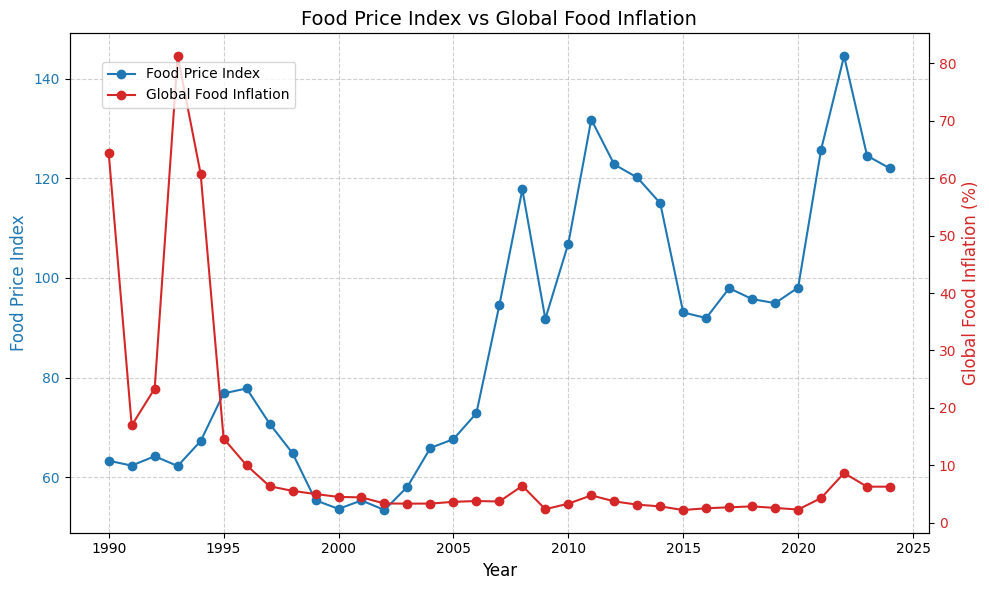

In [ ]:
fig, ax1 = plt.subplots(figsize=(10, 6))

# Convert 'year' column to integers if necessary
merged_df['year'] = merged_df['year'].astype(int)

# Plot the Food Price Index on the primary y-axis
ax1.plot(merged_df['year'], merged_df['food_price_index'], label='Food Price Index', marker='o', color='tab:blue')
ax1.set_xlabel('Year', fontsize=12)
ax1.set_ylabel('Food Price Index', color='tab:blue', fontsize=12)
ax1.tick_params(axis='y', labelcolor='tab:blue')
ax1.grid(True, linestyle='--', alpha=0.6)  # Light grid for better readability

# Create a secondary y-axis
ax2 = ax1.twinx()
ax2.plot(merged_df['year'], merged_df['Global_Food_Inflation'], label='Global Food Inflation', marker='o', color='tab:red')
ax2.set_ylabel('Global Food Inflation (%)', color='tab:red', fontsize=12)
ax2.tick_params(axis='y', labelcolor='tab:red')

# Adding title
plt.title('Food Price Index vs Global Food Inflation', fontsize=14)

# Adding a combined legend
fig.legend(loc='upper left', bbox_to_anchor=(0.1, 0.9))

# Adjust layout
plt.tight_layout()
plt.show()


## **Interpretation of the Trends**:

* **1990-1995:** Global Food Inflation shows high volatility, with a sharp peak around 1992, while the Food Price Index is relatively stable.
* **1995-2005:** Both the Food Price Index and Global Food Inflation exhibit a general downward trend, with low inflation rates and relatively stable food prices.
* **2005-2015:** The Food Price Index shows a significant increase, particularly around 2008 and 2011, indicating rising food prices. Global Food Inflation also increases during this period, though not as dramatically.
* **2015-2025:** The Food Price Index remains relatively high with fluctuations, showing a sharp increase towards 2020-2025. Global Food Inflation also shows an upward trend in the later period, though with less volatility than the Food Price Index.

In [ ]:
! wget -q -O world_data.zip "https://github.com/sg2083/vis/raw/main/wb_countries.zip" # Updated URL
# Extract and load the shapefile
zip_ref = zipfile.ZipFile('world_data.zip', 'r')
zip_ref.extractall('World_Shape_Files')
# Load shapefile
WA0 = gpd.read_file('World_Shape_Files/WB_countries_Admin0_10m/WB_countries_Admin0_10m.shp')

# Create an interactive map using Plotly with hover highlight effect
fig = px.choropleth(
    WA0,
    geojson=WA0.geometry,
    locations=WA0.index,
    hover_name=WA0['NAME_EN'],
    color=WA0.index,  # Unique color per country to allow hover effect
    color_continuous_scale=["#AEEEEE", "#4682B4"],  # Light blue to steel blue transition
)

# Customize the layout
fig.update_geos(
    showcoastlines=True,
    coastlinecolor="white",
    showland=True,
    landcolor="#AEEEEE",
    showocean=True,
    oceancolor="#F0F8FF",
    showframe=False
)

fig.update_traces(
    hoverinfo="location+name",  # Show country name on hover
    marker=dict(line=dict(color='white', width=1))  # White borders for clarity
)

fig.update_layout(
    title_text="🌍 Interactive World Map with Hover Highlight",
    title_x=0.5,
    geo=dict(showlakes=True, lakecolor="white"),
    height=700,
    coloraxis_showscale=False  # Hide unnecessary color scale
)

# Show interactive map
fig.show()


In [ ]:
import unicodedata
general_inflation_url = "https://raw.githubusercontent.com/sg2083/vis/refs/heads/main/general_inflation.xls"
world_general_inflation = pd.read_excel(general_inflation_url, engine='xlrd')
world_general_inflation.head()
world_general_inflation.rename(columns={world_general_inflation.columns[0]: 'Country'}, inplace=True)

# Function to normalize text: removes accents, trims spaces, and converts to lowercase
def normalize_text(text):
    if isinstance(text, str):  # Ensure it's a string before processing
        text = text.strip()  # Remove spaces
        text = unicodedata.normalize('NFKD', text)  # Normalize special characters (e.g., é → e)
        text = text.encode('ascii', 'ignore').decode('utf-8')  # Remove non-ASCII characters
        text = text.lower()  # Convert to lowercase for exact matching
    return text

# List of regions and countries to remove
regions_to_remove = [
    "africa (region)", "asia and pacific", "australia and new zealand", "caribbean", "central america",
    "central asia and the caucasus", "east asia", "eastern europe", "europe", "middle east (region)",
    "north africa", "north america", "pacific islands", "south america", "south asia", "southeast asia",
    "sub-saharan africa (region)", "western europe", "western hemisphere (region)", "advanced economies",
    "asean-5", "emerging and developing asia", "emerging and developing europe", "emerging market and developing economies",
    "euro area", "european union", "latin america and the caribbean", "major advanced economies (g7)",
    "middle east and central asia", "other advanced economies", "sub-saharan africa", "world"
]


regions_to_remove = [normalize_text(region) for region in regions_to_remove]  # Normalize regions list


world_general_inflation['Country'] = world_general_inflation['Country'].apply(normalize_text)

# Remove rows where 'Country' is in the 'regions_to_remove' list
world_general_inflation = world_general_inflation[~world_general_inflation['Country'].isin(regions_to_remove)]
world_general_inflation['Country'] = world_general_inflation['Country'].str.title()

# Display the cleaned dataframe
print(world_general_inflation.head())

       Country     1980     1981     1982     1983     1984     1985     1986  \
0  Afghanistan  no data  no data  no data  no data  no data  no data  no data   
1      Albania  no data  no data  no data  no data  no data  no data  no data   
2      Algeria      9.7     14.6      6.6      7.8      6.3     10.4       14   
3      Andorra  no data  no data  no data  no data  no data  no data  no data   
4       Angola     46.7      1.4      1.8      1.8      1.8      1.8      1.8   

      1987     1988  ...  2020  2021  2022  2023     2024     2025     2026  \
0  no data  no data  ...   5.6   7.8  10.6  -7.7  no data  no data  no data   
1  no data  no data  ...   1.6     2   6.7   4.8      2.2      2.4      2.6   
2      5.9      5.9  ...   2.4   7.2   9.3   9.3      5.3      5.2      4.5   
3  no data  no data  ...   0.1   1.7   6.2   5.6      3.6      2.5        2   
4      1.8      1.8  ...  22.3  25.8  21.4  13.6     28.4     21.3     15.4   

      2027     2028     2029  
0  no d

In [ ]:
# Load a dataset that contains country names and their corresponding ISO_A3 codes
iso_a3_data = {
    "Afghanistan": "AFG", "Albania": "ALB", "Algeria": "DZA", "Andorra": "AND", "Angola": "AGO",
    "Argentina": "ARG", "Armenia": "ARM", "Australia": "AUS", "Austria": "AUT", "Azerbaijan": "AZE",
    "Bahamas": "BHS", "Bahrain": "BHR", "Bangladesh": "BGD", "Barbados": "BRB", "Belarus": "BLR",
    "Belgium": "BEL", "Belize": "BLZ", "Benin": "BEN", "Bhutan": "BTN", "Bolivia": "BOL",
    "Bosnia and Herzegovina": "BIH", "Botswana": "BWA", "Brazil": "BRA", "Brunei": "BRN", "Bulgaria": "BGR",
    "Burkina Faso": "BFA", "Burundi": "BDI", "Cabo Verde": "CPV", "Cambodia": "KHM", "Cameroon": "CMR",
    "Canada": "CAN", "Central African Republic": "CAF", "Chad": "TCD", "Chile": "CHL", "China": "CHN",
    "Colombia": "COL", "Comoros": "COM", "Congo": "COG", "Costa Rica": "CRI", "Croatia": "HRV",
    "Cuba": "CUB", "Cyprus": "CYP", "Czech Republic": "CZE", "Denmark": "DNK", "Djibouti": "DJI",
    "Dominican Republic": "DOM", "Ecuador": "ECU", "Egypt": "EGY", "El Salvador": "SLV", "Estonia": "EST",
    "Eswatini": "SWZ", "Ethiopia": "ETH", "Fiji": "FJI", "Finland": "FIN", "France": "FRA",
    "Gabon": "GAB", "Gambia": "GMB", "Georgia": "GEO", "Germany": "DEU", "Ghana": "GHA",
    "Greece": "GRC", "Guatemala": "GTM", "Guinea": "GIN", "Guyana": "GUY", "Haiti": "HTI",
    "Honduras": "HND", "Hungary": "HUN", "Iceland": "ISL", "India": "IND", "Indonesia": "IDN",
    "Iran": "IRN", "Iraq": "IRQ", "Ireland": "IRL", "Israel": "ISR", "Italy": "ITA",
    "Jamaica": "JAM", "Japan": "JPN", "Jordan": "JOR", "Kazakhstan": "KAZ", "Kenya": "KEN",
    "Kuwait": "KWT", "Kyrgyzstan": "KGZ", "Laos": "LAO", "Latvia": "LVA", "Lebanon": "LBN",
    "Lesotho": "LSO", "Liberia": "LBR", "Libya": "LBY", "Lithuania": "LTU", "Luxembourg": "LUX",
    "Madagascar": "MDG", "Malawi": "MWI", "Malaysia": "MYS", "Maldives": "MDV", "Mali": "MLI",
    "Malta": "MLT", "Mexico": "MEX", "Moldova": "MDA", "Mongolia": "MNG", "Montenegro": "MNE",
    "Morocco": "MAR", "Mozambique": "MOZ", "Myanmar": "MMR", "Namibia": "NAM", "Nepal": "NPL",
    "Netherlands": "NLD", "New Zealand": "NZL", "Nicaragua": "NIC", "Niger": "NER", "Nigeria": "NGA",
    "North Korea": "PRK", "North Macedonia": "MKD", "Norway": "NOR", "Oman": "OMN", "Pakistan": "PAK",
    "Palestine": "PSE", "Panama": "PAN", "Papua New Guinea": "PNG", "Paraguay": "PRY", "Peru": "PER",
    "Philippines": "PHL", "Poland": "POL", "Portugal": "PRT", "Qatar": "QAT", "Romania": "ROU",
    "Russia": "RUS", "Rwanda": "RWA", "Saudi Arabia": "SAU", "Senegal": "SEN", "Serbia": "SRB",
    "Singapore": "SGP", "Slovakia": "SVK", "Slovenia": "SVN", "Somalia": "SOM", "South Africa": "ZAF",
    "South Korea": "KOR", "South Sudan": "SSD", "Spain": "ESP", "Sri Lanka": "LKA", "Sudan": "SDN",
    "Suriname": "SUR", "Sweden": "SWE", "Switzerland": "CHE", "Syria": "SYR", "Tajikistan": "TJK",
    "Tanzania": "TZA", "Thailand": "THA", "Togo": "TGO", "Tunisia": "TUN", "Turkey": "TUR",
    "Turkmenistan": "TKM", "Uganda": "UGA", "Ukraine": "UKR", "United Arab Emirates": "ARE", "United Kingdom": "GBR",
    "United States": "USA", "Uruguay": "URY", "Uzbekistan": "UZB", "Venezuela": "VEN", "Vietnam": "VNM",
    "Yemen": "YEM", "Zambia": "ZMB", "Zimbabwe": "ZWE"
}

# Map country names to ISO_A3 codes
world_general_inflation["ISO_A3"] = world_general_inflation["Country"].map(iso_a3_data).fillna("N/A")

# Display the first few rows
print(world_general_inflation.head())


       Country     1980     1981     1982     1983     1984     1985     1986  \
0  Afghanistan  no data  no data  no data  no data  no data  no data  no data   
1      Albania  no data  no data  no data  no data  no data  no data  no data   
2      Algeria      9.7     14.6      6.6      7.8      6.3     10.4       14   
3      Andorra  no data  no data  no data  no data  no data  no data  no data   
4       Angola     46.7      1.4      1.8      1.8      1.8      1.8      1.8   

      1987     1988  ...  2021  2022  2023     2024     2025     2026  \
0  no data  no data  ...   7.8  10.6  -7.7  no data  no data  no data   
1  no data  no data  ...     2   6.7   4.8      2.2      2.4      2.6   
2      5.9      5.9  ...   7.2   9.3   9.3      5.3      5.2      4.5   
3  no data  no data  ...   1.7   6.2   5.6      3.6      2.5        2   
4      1.8      1.8  ...  25.8  21.4  13.6     28.4     21.3     15.4   

      2027     2028     2029 ISO_A3  
0  no data  no data  no data    AFG 

In [ ]:
# Merge the two dataframes based on the 'ISO_A3' column
merged_data = world_general_inflation.merge(WA0, on='ISO_A3', how='left')

# Display the first few rows of the merged dataframe
print(merged_data.head())
len(merged_data)

       Country     1980     1981     1982     1983     1984     1985     1986  \
0  Afghanistan  no data  no data  no data  no data  no data  no data  no data   
1      Albania  no data  no data  no data  no data  no data  no data  no data   
2      Algeria      9.7     14.6      6.6      7.8      6.3     10.4       14   
3      Andorra  no data  no data  no data  no data  no data  no data  no data   
4       Angola     46.7      1.4      1.8      1.8      1.8      1.8      1.8   

      1987     1988  ...      NAME_SV     NAME_TR      NAME_VI NAME_ZH  \
0  no data  no data  ...  Afghanistan  Afganistan  Afghanistan     阿富汗   
1  no data  no data  ...     Albanien  Arnavutluk      Albania   阿尔巴尼亚   
2      5.9      5.9  ...     Algeriet     Cezayir      Algérie   阿尔及利亚   
3  no data  no data  ...      Andorra     Andorra      Andorra     安道尔   
4      1.8      1.8  ...       Angola      Angola       Angola     安哥拉   

       WB_NAME WB_RULES WB_REGION Shape_Leng  Shape_Area  \
0  Afgha

200

In [ ]:
df_long = df.melt(id_vars=["Country", "ISO_A3"], var_name="Year", value_name="Inflation")
df_long["Year"] = pd.to_numeric(df_long["Year"], errors='coerce')
df_long.dropna(inplace=True)

# Create dropdown for year selection
year_selector = widgets.IntSlider(
    value=2020,  # Default year
    min=df_long["Year"].min(),
    max=df_long["Year"].max(),
    step=1,
    description='Year:',
    continuous_update=False
)

def update_map(selected_year):
    filtered_df = df_long[df_long["Year"] == selected_year]
    fig = px.choropleth(
        filtered_df,
        locations="ISO_A3",
        color="Inflation",
        hover_name="Country",
        color_continuous_scale="Reds",
        title=f"Global Inflation Map - {selected_year}",
        projection="natural earth"
    )
    fig.show()

year_selector.observe(lambda change: update_map(year_selector.value), names='value')

display(year_selector)
update_map(year_selector.value)

### **Key Findings**

#### **1. Nominal vs. Real Food Price Index (FPI)**

| Statistic   | Nominal FPI | Real FPI |
| ----------- | ----------- | -------- |
| **Mean**    | 88.02       | 92.77    |
| **Std Dev** | 26.65       | 18.71    |
| **Min**     | 53.43       | 67.47    |
| **Max**     | 144.51      | 141.39   |

- **Nominal FPI has increased significantly**, reaching a peak of **144.5** in 2024.
- **Real FPI is more stable**, indicating that while food prices have risen, inflation-adjusted prices show a more controlled trend.

#### **2. Food Price Index (Category-Wise) Trends**

- The dataset covers **1990-2024 (35 years)** and includes five food categories.
- No duplicate FPI values per year, suggesting consistent year-to-year tracking.
- Categories exhibit different volatility patterns, with oils and sugars showing higher fluctuations.

#### **3. Global Food Inflation Analysis (1974-2023)**

| Statistic   | Inflation Rate (%) |
| ----------- | ------------------ |
| **Mean**    | 11.77              |
| **Std Dev** | 17.05              |
| **Min**     | 2.21               |
| **Max**     | 81.29              |
| **Median**  | 5.26               |

- The **standard deviation (17.05%)** is quite large compared to the **mean (11.77%)**, indicating that food inflation has experienced **significant fluctuations** over the years.
- The **highest recorded food inflation rate (81.29%)** is **more than 7 times the median value (5.26%)**, showing that certain crisis periods led to **unusually high price surges**.
- The **minimum inflation rate (2.21%)** indicates that there were years of **relative stability**, where food prices were well-contained.  
- The **median (5.26%)** suggests that in most years, food inflation remained low, with **only occasional extreme spikes** pushing up the average.
- This suggests that food prices are generally **stable but highly sensitive to economic and geopolitical shocks**.  

In [ ]:
# Computing Descriptive Statistics
nominal_real_stats = merged_df[['nominal_index', 'real_index']].describe()
inflation_stats = merged_df[['Global_Food_Inflation']].describe()

# Print Key Findings
print("Nominal vs Real Food Price Index Statistics:")
print(nominal_real_stats)
print("\nInflation Rate Statistics:")
print(inflation_stats)

print(merged_df)

Nominal vs Real Food Price Index Statistics:
       nominal_index  real_index
count      35.000000   35.000000
mean       88.028408   92.775064
std        26.653299   18.712575
min        53.432698   67.477205
25%        64.524662   77.087731
50%        91.787853   94.051055
75%       110.928596  106.600776
max       144.509866  141.390951

Inflation Rate Statistics:
       Global_Food_Inflation
count              35.000000
mean               11.013096
std                18.693280
min                 2.209405
25%                 3.231876
50%                 4.290260
75%                 6.385648
max                81.295594
    year food_price_index  meat_index dairy_index cereals_index  oils_index  \
0   1990        63.317606   82.453911   42.621158     58.079751   45.469775   
1   1991        62.345284   81.474667   45.460326      57.86382   49.007954   
2   1992        64.225559   78.387289   54.801593     60.957651   52.991996   
3   1993        62.259405   75.014033   48.616516    

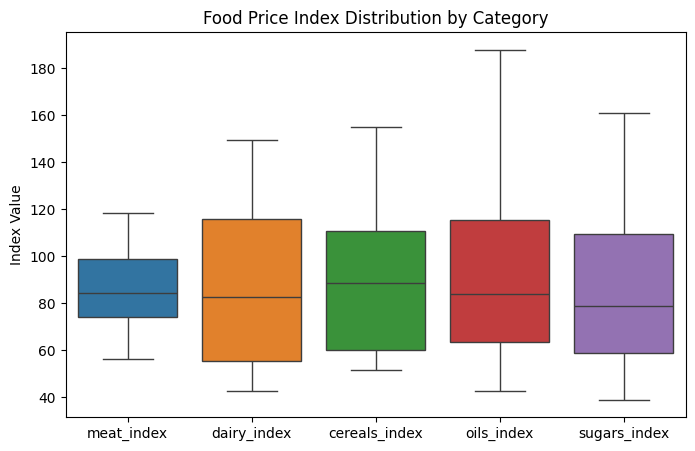

In [ ]:
import seaborn as sns

plt.figure(figsize=(8, 5))
sns.boxplot(data=merged_df[["meat_index", "dairy_index", "cereals_index", "oils_index", "sugars_index"]])
plt.title("Food Price Index Distribution by Category")
plt.ylabel("Index Value")
plt.show()


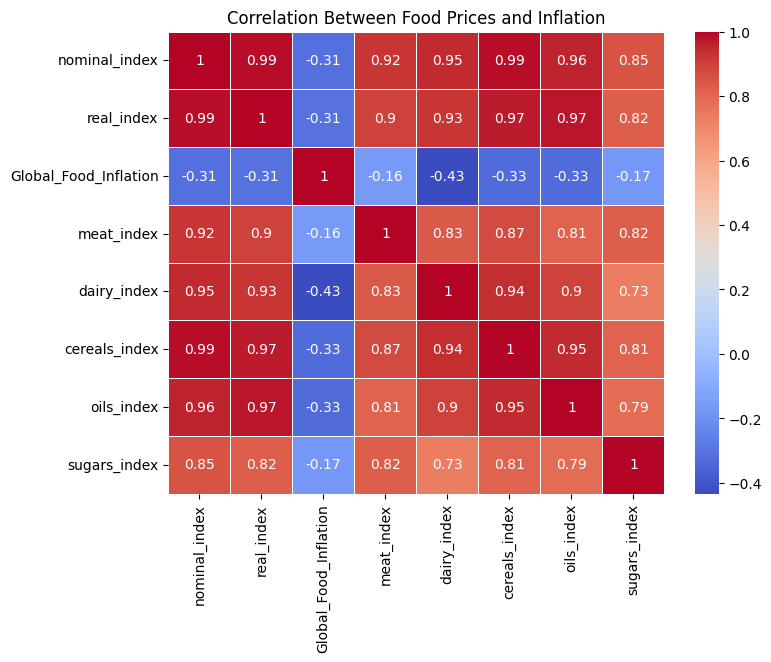

In [ ]:
# ---------------------- 5. Correlation Heatmap ----------------------
plt.figure(figsize=(8, 6))
correlation_matrix = merged_df[["nominal_index", "real_index", "Global_Food_Inflation", "meat_index", "dairy_index", "cereals_index", "oils_index", "sugars_index"]].corr()
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", linewidths=0.5)
plt.title("Correlation Between Food Prices and Inflation")
plt.show()

### **Conclusions & Next Steps**

- **Hypothesis 1 (H1): There is a positive correlation between food price indices and general inflation.**  
  - **Partially Supported** – While food prices and inflation are connected, the correlation is **moderate to weak (-0.31)** rather than strongly positive.
- **Hypothesis 2 (H2): Inflation-adjusted food prices (real FPI) show less volatility than nominal food prices.**  
  - **Supported** – The **real FPI has a lower standard deviation (18.71) compared to nominal FPI (26.65)**, confirming that **inflation-adjusted prices are more stable**.
- **Further analysis required** to evaluate how different food categories react to economic conditions (H3).
- **Next Steps:** Conduct regression analysis to quantify inflation’s impact on food prices, explore country-specific trends, and integrate additional economic variables such as GDP and wage growth.